In [1]:
%pip install lxml
%pip install rasterio
%pip install xarray
%pip install urllib3
%pip install erddapy
%pip install pydap
%pip install contextily 
%pip install matplotlib_scalebar
%pip install utm
%pip install esda
%pip install pysal

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 24.3 MB/s eta 0:00:0000:0100:01
Note: you may need to restart the kernel to use updated packages.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 404.9/404.9 kB 12.5 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for rasterio: filename=rasterio-1.3.2-cp39-cp39-linux_aarch64.whl size=1410800 sha256=85da97cad68c3cf93adb341226078ea3ca38f2c1a393d8340876500b891a068b
  Stored in directory: /home/jovyan/.cache/pip/wheels/f2/73/6b/6793bc8d6bdacb5f8ff32cda200bdd6b8dad65f46adb07e916
Successfully built rasterio
Note: you may need to restart the kernel to use updated packages.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 947.6/947.6 kB 17.6 MB/s eta 0:00:00a 0:00:01
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart th

In [1]:
import pandas as pd
from scripts import smallest_enclosing_circle as ec
from scripts import system_codes
import math, random

In [2]:
# Standard library
from datetime import datetime

# Third-party libraries
import contextily as cx
import folium
import geopandas as gpd
import pandas as pd
import matplotlib.cbook as cbook
import matplotlib.pyplot as plt
import matplotlib_scalebar
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sb
import utm
from esda import Moran_Local
from esda.moran import Moran
from IPython.display import display, HTML
from libpysal.weights.contiguity import Queen
from matplotlib_scalebar.scalebar import ScaleBar
from pysal.lib import weights
from shapely.geometry import Point, Polygon
from splot.esda import moran_scatterplot



### Load Datasets

In [3]:
# Preview buoy measurements
buoy_df = pd.read_csv("data/buoys.tsv", delimiter = '\t')
buoy_df.head()

,sensor_id,datetime,latitude,longitude,acceleration_mean,acceleration_q3,battery_soc,cloud_battery_soc,depth_mean,depth_q3,...,fast_update,last_updated,long_life,momsn,next_update,position_delta,speed,system_status,water_temperature_mean,water_temperature_q3
0,103,2021-03-25 18:01:08,37.471260,-121.940110,0.044290,0.085678,100.0,100.0,0.0,0.0,...,NaN,NaN,NaN,0,120,0.0,1.09,1557.0,23.0,23.0
1,103,2021-03-25 18:05:25,37.471252,-121.940216,0.070422,0.121168,100.0,100.0,0.0,0.0,...,NaN,NaN,NaN,1,120,0.0,0.00,33554960.0,23.0,23.0
2,103,2021-03-26 00:15:04,37.471207,-121.940300,0.375599,0.868697,100.0,100.0,0.0,0.0,...,NaN,NaN,NaN,2,120,0.0,0.36,34325.0,23.0,23.0
3,103,2021-03-26 00:19:13,37.471207,-121.940300,0.073840,0.143368,100.0,100.0,0.0,0.0,...,NaN,NaN,NaN,3,120,0.0,0.00,33296.0,24.0,24.0
4,103,2021-04-01 17:43:23,37.471222,-121.940600,0.041170,0.121168,92.0,100.0,0.0,0.0,...,NaN,NaN,NaN,4,120,0.0,0.08,34325.0,25.0,25.0


In [4]:
# Preview fisheries
fishery_df = pd.read_csv("data/fisheries.tsv", delimiter='\t')
fishery_df.head()

,id,location,catch,gear
0,1,Maine,Lobster,Single-line pots
1,2,Massachusetts,Swordfish,Long-line hooks
2,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots


In [5]:
# # Preview buoy fishery assignments
buoy_fishery_df = pd.read_csv("data/buoy_fishery_assignments.tsv", delimiter='\t')
buoy_fishery_df.head()

,buoy_id,fishery_id
0,103,3
1,104,3
2,105,3
3,106,3
4,107,3


In [14]:
# Merge buoy_df and buoy_fisheries_assignment dataframes

merged_buoy_df = pd.merge(buoy_df, buoy_fishery_df, 
                          left_on = 'sensor_id', 
                          right_on = 'buoy_id')
merged_buoy_df.head(5)

,sensor_id,datetime,latitude,longitude,acceleration_mean,acceleration_q3,battery_soc,cloud_battery_soc,depth_mean,depth_q3,...,long_life,momsn,next_update,position_delta,speed,system_status,water_temperature_mean,water_temperature_q3,buoy_id,fishery_id
0,103,2021-03-25 18:01:08,37.471260,-121.940110,0.044290,0.085678,100.0,100.0,0.0,0.0,...,NaN,0,120,0.0,1.09,1557.0,23.0,23.0,103,3
1,103,2021-03-25 18:05:25,37.471252,-121.940216,0.070422,0.121168,100.0,100.0,0.0,0.0,...,NaN,1,120,0.0,0.00,33554960.0,23.0,23.0,103,3
2,103,2021-03-26 00:15:04,37.471207,-121.940300,0.375599,0.868697,100.0,100.0,0.0,0.0,...,NaN,2,120,0.0,0.36,34325.0,23.0,23.0,103,3
3,103,2021-03-26 00:19:13,37.471207,-121.940300,0.073840,0.143368,100.0,100.0,0.0,0.0,...,NaN,3,120,0.0,0.00,33296.0,24.0,24.0,103,3
4,103,2021-04-01 17:43:23,37.471222,-121.940600,0.041170,0.121168,92.0,100.0,0.0,0.0,...,NaN,4,120,0.0,0.08,34325.0,25.0,25.0,103,3


In [19]:
buoy_df_all = pd.merge(merged_buoy_df, fishery_df, left_on = 'fishery_id', right_on = 'id')
buoy_df_all.drop(['sensor_id','id'],axis = 1, inplace = True)
buoy_df_all.head()

,datetime,latitude,longitude,acceleration_mean,acceleration_q3,battery_soc,cloud_battery_soc,depth_mean,depth_q3,dive_count,...,position_delta,speed,system_status,water_temperature_mean,water_temperature_q3,buoy_id,fishery_id,location,catch,gear
0,2021-03-25 18:01:08,37.471260,-121.940110,0.044290,0.085678,100.0,100.0,0.0,0.0,0.0,...,0.0,1.09,1557.0,23.0,23.0,103,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots
1,2021-03-25 18:05:25,37.471252,-121.940216,0.070422,0.121168,100.0,100.0,0.0,0.0,0.0,...,0.0,0.00,33554960.0,23.0,23.0,103,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots
2,2021-03-26 00:15:04,37.471207,-121.940300,0.375599,0.868697,100.0,100.0,0.0,0.0,0.0,...,0.0,0.36,34325.0,23.0,23.0,103,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots
3,2021-03-26 00:19:13,37.471207,-121.940300,0.073840,0.143368,100.0,100.0,0.0,0.0,0.0,...,0.0,0.00,33296.0,24.0,24.0,103,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots
4,2021-04-01 17:43:23,37.471222,-121.940600,0.041170,0.121168,92.0,100.0,0.0,0.0,0.0,...,0.0,0.08,34325.0,25.0,25.0,103,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots


In [21]:
buoy_df_all['datetime'] = pd.to_datetime(buoy_df_all['datetime'])
buoy_df_all['date'] = buoy_df_all['datetime'].dt.date
buoy_df_all = buoy_df_all.sort_values('date', ascending=True)
buoy_df_all.head()

,datetime,latitude,longitude,acceleration_mean,acceleration_q3,battery_soc,cloud_battery_soc,depth_mean,depth_q3,dive_count,...,speed,system_status,water_temperature_mean,water_temperature_q3,buoy_id,fishery_id,location,catch,gear,date
1139,2021-03-10 22:45:44,37.471283,-121.94046,0.060094,0.167018,97.0,100.0,0.0,0.0,0.0,...,0.03,1557.0,17.0,17.0,108,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2021-03-10
4496,2021-03-10 22:10:25,37.471100,-121.94022,0.057832,0.121168,97.0,100.0,0.0,0.0,0.0,...,0.08,1557.0,20.0,20.0,127,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2021-03-10
4497,2021-03-10 22:14:42,37.471100,-121.94022,0.056093,0.093856,97.0,100.0,0.0,0.0,0.0,...,0.00,528.0,17.0,17.0,127,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2021-03-10
1140,2021-03-10 22:50:05,37.471283,-121.94046,0.047532,0.093856,97.0,100.0,0.0,0.0,0.0,...,0.00,528.0,18.0,18.0,108,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2021-03-10
1141,2021-03-11 22:47:34,37.471060,-121.94024,0.062445,0.121168,96.0,100.0,0.0,0.0,0.0,...,0.31,1557.0,21.0,21.0,108,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2021-03-11


### Buoy Message Analysis 

#### Total Number of Messages

How many unique buoys are in the dataset? Messages? 

In [25]:
unique_buoys = len(buoy_df_all['buoy_id'].unique())
unique_buoys 

169

In [26]:
count_messages = len(buoy_df_all)
count_messages

31398

There are 169 unique buoys in the dataset, 31,398 messages

#### Data Fields

 List the message dataset fields/columns. Do any strong negative or positive correlations exist between fields? Produce a correlation matrix as a visualization. Are there fields/columns that contain null, dummy, or missing values?

In [27]:
buoy_df_all.columns

Index(['datetime', 'latitude', 'longitude', 'acceleration_mean',
       'acceleration_q3', 'battery_soc', 'cloud_battery_soc', 'depth_mean',
       'depth_q3', 'dive_count', 'dive_time', 'fast_update', 'last_updated',
       'long_life', 'momsn', 'next_update', 'position_delta', 'speed',
       'system_status', 'water_temperature_mean', 'water_temperature_q3',
       'buoy_id', 'fishery_id', 'location', 'catch', 'gear', 'date'],
      dtype='object')

<AxesSubplot:>

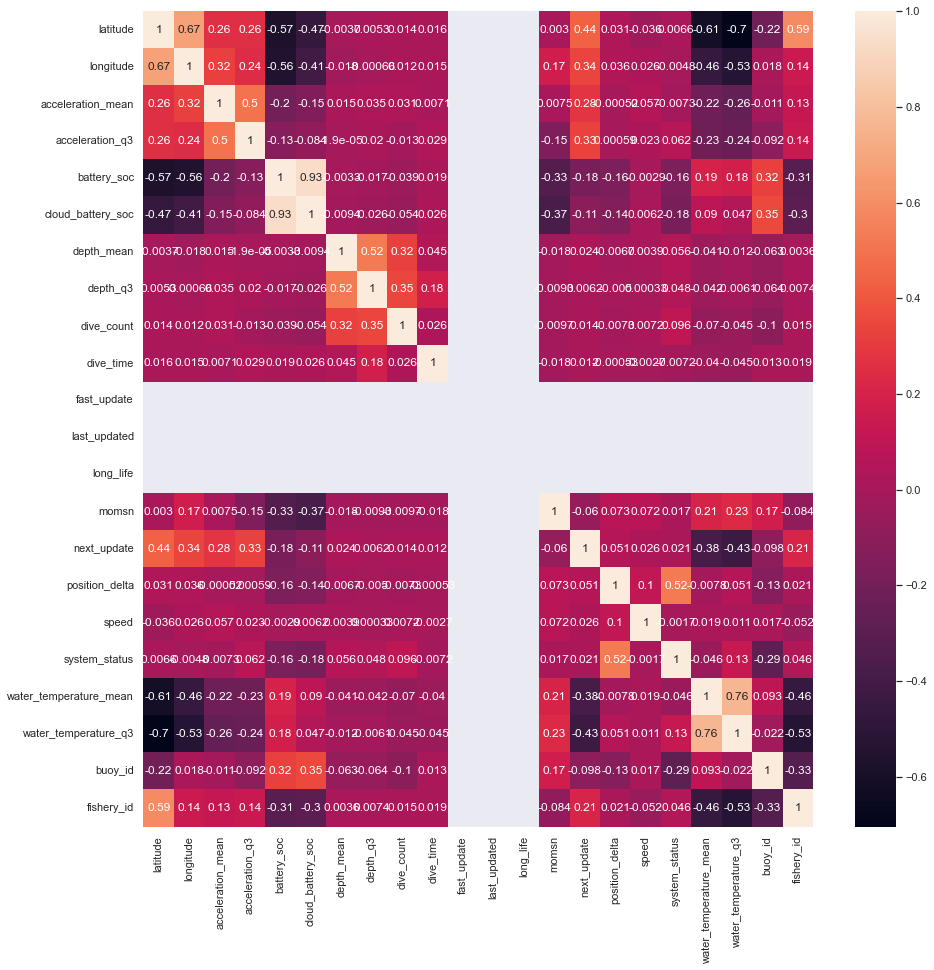

In [28]:
corr = buoy_df_all.corr()
sb.set(rc = {'figure.figsize':(15,15)})
sb.heatmap(corr, annot = True)

There are strong positive correlation exists between water_temperature_mean and water_temperature_q3 (0.76), modest positive correlation between latitude and longitutde (0.67); strong negative relationship between latitude and water_temperature_q3(-0.7), and modest negative correlation between water_temperature_mean and latitude (-0.61)

In [29]:
buoy_df_all.isnull().sum()

datetime                      0
latitude                     20
longitude                    20
acceleration_mean            20
acceleration_q3              20
battery_soc                  20
cloud_battery_soc            20
depth_mean                   20
depth_q3                     20
dive_count                   20
dive_time                    20
fast_update               31398
last_updated              31398
long_life                 31398
momsn                         0
next_update                   0
position_delta               20
speed                        20
system_status                20
water_temperature_mean       20
water_temperature_q3         20
buoy_id                       0
fishery_id                    0
location                      0
catch                         0
gear                          0
date                          0
dtype: int64

The entire columns of 'fast_update,' 'last_updated,' and 'long_live' have all missing values/nulls. There are several missing values/nulls for variables like 'latitude,' 'longitude,' 'acceleration_mean,' 'acceleration_q3' and so on

In [30]:
buoy_df_all.dtypes

datetime                  datetime64[ns]
latitude                         float64
longitude                        float64
acceleration_mean                float64
acceleration_q3                  float64
battery_soc                      float64
cloud_battery_soc                float64
depth_mean                       float64
depth_q3                         float64
dive_count                       float64
dive_time                        float64
fast_update                      float64
last_updated                     float64
long_life                        float64
momsn                              int64
next_update                        int64
position_delta                   float64
speed                            float64
system_status                    float64
water_temperature_mean           float64
water_temperature_q3             float64
buoy_id                            int64
fishery_id                         int64
location                          object
catch           

There are no dummy variables

#### Analyze Messages by buoy

How are messages distributed across buoys? Did some buoys transmit many more messages than others? Produce a graph (e.g., bar plot, histogram, box-and-whisker plot) to visualize this.

In [31]:
fig = px.histogram(buoy_df_all, x = 'buoy_id')
fig.update_layout(bargap = 0.2)
fig.show()

buoy_id 540 -549 transmit more messages than the others. buoy_id 300-309, 600-609 transmit far less messages than the others. 

max message buoy_id, median, average 

#### Analyze messages over time 

What is the date range of the buoy messages? How are messages spread across time?  Are they concentrated in a particular week or month, or fairly spread out?


In [32]:
min_date = buoy_df_all['date'].min()
max_date = buoy_df_all['date'].max()
display(HTML(f"<ul><li>the date range is between {min_date} and {max_date}, inclusive.</li><ul>"))


In [33]:
fig = px.histogram(buoy_df_all, x = 'date')
fig.update_layout(bargap = 0.2)
fig.show()

The buoy messages are mostly concentrated in May and June 2022.

#### Analyze Messages by Geography

What is the geographic distribution of messages (i.e., what are the geographic coordinates of a “bounding box” that would contain all buoys)?  Are any outside the expected territory? To visualize this, produce an interactive map with all of the messages plotted as points as well as a rectangular bounding box representing the min and max coordinates.

In [34]:
# Determine approximate "bounding box" of all buoys' latitude and longitude
desc_stats = buoy_df_all.describe()
lat_col = 'latitude'
lon_col = 'longitude'

southwest = (desc_stats[lat_col]['min'], desc_stats[lon_col]['min'])
southeast = (desc_stats[lat_col]['min'], desc_stats[lon_col]['max'])
northwest = (desc_stats[lat_col]['max'], desc_stats[lon_col]['min'])
northeast = (desc_stats[lat_col]['max'], desc_stats[lon_col]['max'])

print("Bounding Box")
print(f"Northwest: {northwest}")
print(f"Northeast: {northeast}")
print(f"Southwest: {southwest}")
print(f"Southeast: {southeast}")

Bounding Box
Northwest: (50.027603, -122.50294)
Northeast: (50.027603, 0.0)
Southwest: (0.0, -122.50294)
Southeast: (0.0, 0.0)


In [36]:
# Plot all buoy measurements with bounding box
corners = [northeast, northwest, southwest, southeast, northeast]
corner_lats = [c[0] for c in corners]
corner_lons = [c[1] for c in corners]

fig = go.Figure(go.Scattermapbox(
    name = "Bounding Box",
    mode = "markers+lines",
    lon = corner_lons,
    lat = corner_lats,
    marker = {'size': 1},
    line={"color": "yellow"}))

fig.add_trace(go.Scattermapbox(
    name = "Buoy Locations",
    mode = "markers",
    lon = buoy_df_all['longitude'],
    lat = buoy_df_all['latitude'],
    marker = {'size': 5},
    hovertext = buoy_df_all['buoy_id'].apply(lambda id: f"Buoy {id}")))

fig.update_layout(
    margin ={'l':0,'t':0,'b':0,'r':0},
    mapbox = {
        'center': {'lon': 10, 'lat': 10},
        'style': "stamen-terrain",
        'center': {'lon': -126, 'lat': 44},
        'zoom': 2})

fig.show()

There are outliers in CA, Quebec, which are outside of expected territory

### Analyze messages by fishery 

Each message occurs within a given fishery (e.g., lobster, crab). Which buoys were present in each fishery? How many messages occurred within each fishery? What was the date range of messages for each fishery?  Update the map to color-code messages by fishery (include a legend).

In [19]:
fishery_df.head()

,id,location,catch,gear
0,1,Maine,Lobster,Single-line pots
1,2,Massachusetts,Swordfish,Long-line hooks
2,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots


In [202]:
fishery_df = fishery_df.rename(columns = {'id':'fishery_id'})
#merge fishery_df with buoy_fisher_df by fishery_id
buoy_fishery_df_new = pd.merge(fishery_df, buoy_fishery_df, on='fishery_id')
buoy_df = buoy_df.rename(columns = {"sensor_id":"buoy_id"})
#merge all three dataframes
buoy_fishery_df_all = pd.merge(buoy_fishery_df_new, buoy_df, on = 'buoy_id')

In [203]:
buoy_fishery_df_all.head()

,fishery_id,location,catch,gear,buoy_id,datetime,latitude,longitude,acceleration_mean,acceleration_q3,...,last_updated,long_life,momsn,next_update,position_delta,speed,system_status,water_temperature_mean,water_temperature_q3,date
0,1,Maine,Lobster,Single-line pots,587,2022-05-04 20:36:26,37.471245,-121.940220,0.060889,0.114950,...,NaN,NaN,6,0,0.0,0.00,528.0,26.0,26.0,2022-05-04
1,1,Maine,Lobster,Single-line pots,587,2022-05-04 20:27:06,37.471245,-121.940220,1.253542,2.854521,...,NaN,NaN,5,1440,0.0,0.08,67110421.0,26.0,26.0,2022-05-04
2,1,Maine,Lobster,Single-line pots,587,2022-05-05 17:05:54,37.471250,-121.940160,0.067473,0.157983,...,NaN,NaN,7,1440,0.0,0.25,1813.0,23.0,23.0,2022-05-05
3,1,Maine,Lobster,Single-line pots,587,2022-05-05 17:20:11,37.471250,-121.940160,0.044070,0.138152,...,NaN,NaN,8,0,0.0,0.00,528.0,23.0,23.0,2022-05-05
4,1,Maine,Lobster,Single-line pots,587,2022-05-11 15:10:08,37.471245,-121.940315,0.061983,0.121168,...,NaN,NaN,10,0,0.0,0.00,528.0,21.0,21.0,2022-05-11


In [204]:
group_fishery = buoy_fishery_df_all.groupby('catch')
for a in group_fishery['catch'].apply(list).index:
    print(a)

Lobster
Snow crab
Swordfish


In [205]:
def messagebyfishery(fishery):
    '''
    Input: a dataframe; a string indicates a particular fishery (lobster, snowcrab, swrdfish)
    Returns: a list of buoys in this fishery;
            an integer indicates the number of messages within this fishery;
            date range of messages in this fishery
    '''
#     group_fishery = df.groupby('catch')
#     buoy_lst = []
#     num_message = 0
#     for a in group_fishery['catch'].apply(list).index:
    buoys = group_fishery.get_group(fishery)['buoy_id'].unique()
    buoy_lst = buoys.tolist()
    buoy_lst_display = display(HTML(f"<ul><li>the buoys present in this fishery include {buoy_lst}"))
        
    num_message = len(group_fishery.get_group(fishery))
    message_display = display(HTML(f"<ul><li>the number of message occurred in this fishery is {num_message}"))
    
    fishery_min_date = group_fishery.get_group(fishery)['date'].min()
    fishery_max_date = group_fishery.get_group(fishery)['date'].max()
    date_range = display(HTML(f"<ul><li>the date range of messages for this fishery is between {fishery_min_date} and {fishery_max_date}, inclusive.</li><ul>"))
    
    return buoy_lst_display, message_display, date_range
    
    

In [206]:
messagebyfishery('Lobster')

(None, None, None)

In [207]:
messagebyfishery('Snow crab')

(None, None, None)

In [208]:
messagebyfishery('Swordfish')

(None, None, None)

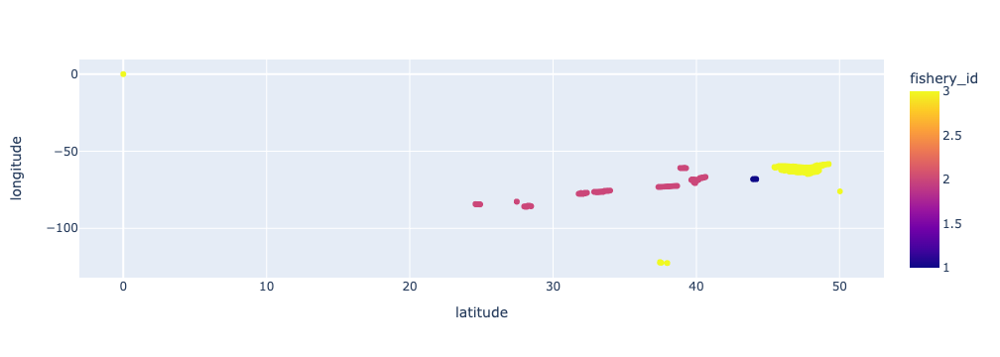

In [209]:
px.scatter(buoy_fishery_df_all, x="latitude", y="longitude", color="fishery_id")

In [210]:
def map_fisher_points(df: pd.DataFrame):
    """
      Plots buoy messages from each fisher on 
    """
  # Determine approximate "bounding box" of latitude and longitude
    lat_col = 'latitude'
    lon_col = 'longitude'
    desc_stats = df.describe()
    southwest = (desc_stats[lat_col]['min'], desc_stats[lon_col]['min'])
    southeast = (desc_stats[lat_col]['min'], desc_stats[lon_col]['max'])
    northwest = (desc_stats[lat_col]['max'], desc_stats[lon_col]['min'])
    northeast = (desc_stats[lat_col]['max'], desc_stats[lon_col]['max'])

    corners = [northeast, northwest, southwest, southeast, northeast]
    corner_lats = [c[0] for c in corners]
    corner_lons = [c[1] for c in corners]

    fig = go.Figure(go.Scattermapbox(
        mode = "markers+lines",
        lon = corner_lons,
        lat = corner_lats,
        marker = {'size': 1, "opacity": 1},
        line={"color": "yellow"}))

    for fishery_id in [1, 2,3]:
        fisher_dataset = df.query('`fishery_id` == @fishery_id')
        if fishery_id == 1:
            marker_color = 'blue'
        elif fishery_id == 2:
            marker_color = 'green'
        else:
            marker_color = 'red'

        hover_text = fisher_dataset.apply(
            func=lambda r: f"Buoy {r['buoy_id']} @ {r['date']}",
          axis="columns")

        fig.add_trace(go.Scattermapbox(
            name=f"Fisher {fishery_id}",
            mode = "markers",
            lon = fisher_dataset['longitude'],
            lat = fisher_dataset['latitude'],
            marker = {'size': 5, "opacity": 1, "color": marker_color},
            hovertext = hover_text))

        fig.update_layout(
          margin ={'l':0,'t':0,'b':0,'r':0},
          mapbox = {
              'center': {'lon': 10, 'lat': 10},
              'style': "stamen-terrain",
              'center': {'lon': -126, 'lat': 44},
              'zoom': 2})

    fig.show()


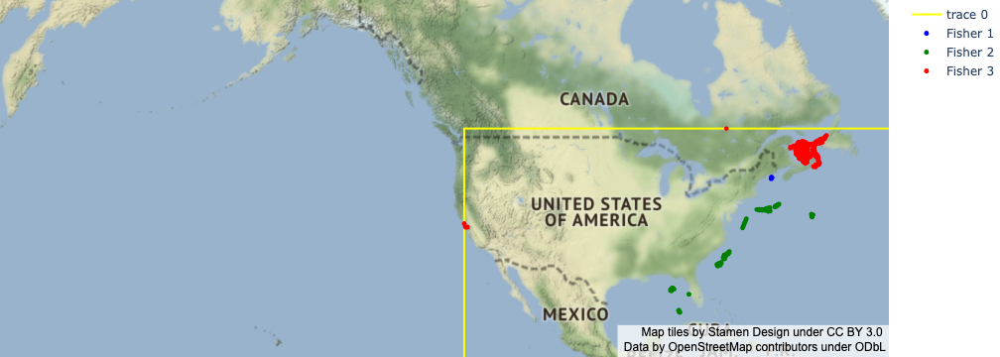

In [211]:
map_fisher_points(buoy_fishery_df_all)

#### Label Messages with Buoy Deployment Identifiers

A buoy “deployment” begins when it enters the water (as indicated by an “Entered Water” status) and ends when it leaves the water (“Left Water”). Assign each buoy message a deployment id that represents the deployment that it was a part of. How many deployments occurred? How many times was each buoy deployed? How long did each deployment last?  How many messages are in each deployment (i.e. how long is each time series)?


In [257]:
buoy_df_all.columns

Index(['datetime', 'latitude', 'longitude', 'acceleration_mean',
       'acceleration_q3', 'battery_soc', 'cloud_battery_soc', 'depth_mean',
       'depth_q3', 'dive_count', 'dive_time', 'fast_update', 'last_updated',
       'long_life', 'momsn', 'next_update', 'position_delta', 'speed',
       'system_status', 'water_temperature_mean', 'water_temperature_q3',
       'buoy_id', 'fishery_id', 'location', 'catch', 'gear', 'date'],
      dtype='object')

In [258]:
buoy_df_all.head()

,datetime,latitude,longitude,acceleration_mean,acceleration_q3,battery_soc,cloud_battery_soc,depth_mean,depth_q3,dive_count,...,speed,system_status,water_temperature_mean,water_temperature_q3,buoy_id,fishery_id,location,catch,gear,date
1139,2021-03-10 22:45:44,37.471283,-121.94046,0.060094,0.167018,97.0,100.0,0.0,0.0,0.0,...,0.03,1557.0,17.0,17.0,108,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2021-03-10
4496,2021-03-10 22:10:25,37.471100,-121.94022,0.057832,0.121168,97.0,100.0,0.0,0.0,0.0,...,0.08,1557.0,20.0,20.0,127,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2021-03-10
4497,2021-03-10 22:14:42,37.471100,-121.94022,0.056093,0.093856,97.0,100.0,0.0,0.0,0.0,...,0.00,528.0,17.0,17.0,127,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2021-03-10
1140,2021-03-10 22:50:05,37.471283,-121.94046,0.047532,0.093856,97.0,100.0,0.0,0.0,0.0,...,0.00,528.0,18.0,18.0,108,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2021-03-10
1141,2021-03-11 22:47:34,37.471060,-121.94024,0.062445,0.121168,96.0,100.0,0.0,0.0,0.0,...,0.31,1557.0,21.0,21.0,108,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2021-03-11


In [259]:
buoy_df_all['system_status'].isnull()

1139     False
4496     False
4497     False
1140     False
1141     False
         ...  
31035    False
31137    False
31396    False
31239    False
31397    False
Name: system_status, Length: 31398, dtype: bool

In [260]:
buoy_df_all['system_status'] = buoy_df_all['system_status'].fillna('Unknown')

In [261]:
buoy_df_all['system_status_int'] = buoy_df_all['system_status'].apply(lambda x : int(x) if x != 'Unknown' else 'Unknown')
buoy_df_all['system_status_int']

1139     1557
4496     1557
4497      528
1140      528
1141     1557
         ... 
31035    1045
31137    1045
31396    1045
31239    1045
31397    1045
Name: system_status_int, Length: 31398, dtype: object

In [264]:
buoy_df_all['system_status_cat'] = buoy_df_all['system_status_int'].apply(lambda x : system_codes.parse_system_flags(x) if x!= 'Unknown' else 'Unknown')

In [265]:
buoy_df_all['system_status_interpret'] = buoy_df_all['system_status_cat'].apply(lambda x:system_codes.human_readable_reason(x))

In [266]:
buoy_df_all['system_status_interpret']

1139     Entered Water
4496     Entered Water
4497        Left Water
1140        Left Water
1141     Entered Water
             ...      
31035        Scheduled
31137        Scheduled
31396        Scheduled
31239        Scheduled
31397        Scheduled
Name: system_status_interpret, Length: 31398, dtype: object

How many deployments occurred? 

In [267]:
# Sort the buoy data points by buoy_id and timestamp (so each buoy is organized sequentially)
buoy_df_all = buoy_df_all.sort_values(by=['buoy_id', 'datetime']).reset_index(drop=True)
deployment_num = 0

# Deployment number increments at each location where system status equals 'Entered Water'
for index, row in buoy_df_all.iterrows():
    if row['system_status_interpret'] == 'Entered Water':
        deployment_num += 1

    # Check to ensure that in case a buoy is placed in water without reporting 'Entered Water'
    elif row['system_status_interpret'] != 'Entered Water' and index >= 1:
        if row['buoy_id'] != buoy_df_all.loc[index-1]['buoy_id']:
            deployment_num += 1

    buoy_df_all.at[index, 'deployment_id'] = deployment_num

In [268]:
deployment_num  #2843 deployment occurs 

2843

How many times was each buoy deployed?

In [269]:
buoy_df_all.groupby(['buoy_id'])['deployment_id'].nunique()

buoy_id
103    29
104    27
105    16
106     7
107    34
       ..
673     2
674    38
678    41
679    36
680    38
Name: deployment_id, Length: 169, dtype: int64

How long did each deployment last?

In [271]:
def get_cols(grp):
    first = grp['datetime']['first'].iloc[0]
    last = grp['datetime']['last'].iloc[0]
    duration = last - first
    return first, last, duration

In [273]:
temp = (buoy_df
  .groupby(["deployment_id"])[['datetime']]
  .agg(['first', 'last'])
  .groupby(["deployment_id"])
  .apply(get_cols)
  .to_frame()
  .reset_index()
  .rename(columns={0:'time_info'}))

temp[['set_on', 'hauled_on', 'duration']] = pd.DataFrame(temp['time_info'].tolist(), index=temp.index)
deployments_df = temp[['deployment_id', 'set_on', 'hauled_on', 'duration']]
deployments_df = deployments_df.merge(
    right=buoy_df[['deployment_id']],
    on='deployment_id',
    how='left')
#deployments_df.drop_duplicates(inplace=True)
deployments_df

KeyError: 'deployment_id'

How many messages are in each deployment?

In [299]:
message_by_deployment = buoy_df_all.groupby(['deployment_id']).count()[['momsn']].rename(columns={"momsn": "num_messages"}).sort_values("num_messages")

In [300]:
message_by_deployment = message_by_deployment.reset_index()


In [310]:
message_by_deployment

,deployment_id,num_messages
0,854.0,1
1,85.0,1
2,671.0,1
3,346.0,1
4,482.0,1
...,...,...
2838,649.0,754
2839,1763.0,830
2840,2580.0,942
2841,2037.0,989


In [309]:
message_by_deployment['num_messages'].describe()

count    2843.000000
mean       11.043968
std        40.525053
min         1.000000
25%         2.000000
50%         9.000000
75%        12.000000
max      1052.000000
Name: num_messages, dtype: float64

In [296]:
fig = px.histogram(message_by_deployment,x = 'num_messages')
fig.update_layout(bargap = 0.2, )
fig.show()

In [275]:
deployment_count_df = (buoy_df_all
                       .groupby(["deployment_id", "buoy_id"])
                       .count()[['momsn']]
                       .rename(columns={"momsn": "num_messages"})
                       .sort_values("num_messages"))
deployment_count_df.reset_index(level="buoy_id", inplace=True)

In [276]:
deployment_count_df

,buoy_id,num_messages
deployment_id,,
854.0,472,1
85.0,107,1
671.0,461,1
346.0,118,1
482.0,125,1
...,...,...
649.0,460,754
1763.0,529,830
2580.0,577,942


### Drop Bad data

 Drop any errant messages that (a) occur outside the expected geographic zone and/or (b) are the only message in their deployment. If applicable, document which messages were dropped and why.


In [313]:
# Plot all buoy measurements with bounding box
corners = [northeast, northwest, southwest, southeast, northeast]
corner_lats = [c[0] for c in corners]
corner_lons = [c[1] for c in corners]

fig = go.Figure(go.Scattermapbox(
    name = "Bounding Box",
    mode = "markers+lines",
    lon = corner_lons,
    lat = corner_lats,
    marker = {'size': 1},
    line={"color": "yellow"}))

fig.add_trace(go.Scattermapbox(
    name = "Buoy Locations",
    mode = "markers",
    lon = filtered_buoys['longitude'],
    lat = filtered_buoys['latitude'],
    marker = {'size': 5},
    hovertext = filtered_buoys['buoy_id'].apply(lambda id: f"Buoy {id}")))

fig.update_layout(
    margin ={'l':0,'t':0,'b':0,'r':0},
    mapbox = {
        'center': {'lon': 10, 'lat': 10},
        'style': "stamen-terrain",
        'center': {'lon': -126, 'lat': 44},
        'zoom': 2})

fig.show()

Filter out buoy measurement readings that are located in CA, Canada, and near Africa. Only focusing on coastal regions of New Brunswick/Gulf of St. Lawrence, Maine, or Massachusetts

In [312]:

filtered_buoys = buoy_df_all[(buoy_df_all.longitude >= -77.60128) & (buoy_df_all.longitude <= -58.327663) & (buoy_df_all.latitude <= 49.237) & (buoy_df_all.latitude >= 31.885447)]
print(f"There are {len(filtered_buoys):,} readings left after filtering.")
print(f"{len(buoy_df) - len(filtered_buoys)} readings were removed.")
filtered_buoys

There are 29,809 readings left after filtering.
1589 readings were removed.


,datetime,latitude,longitude,acceleration_mean,acceleration_q3,battery_soc,cloud_battery_soc,depth_mean,depth_q3,dive_count,...,buoy_id,fishery_id,location,catch,gear,date,system_status_int,system_status_cat,system_status_interpret,deployment_id
15,2022-04-13 21:23:06,47.484776,-63.311108,0.413450,0.638865,48.0,64.0,0.0,0.0,0.0,...,103,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2022-04-13,1557,"[in_water, update_reason_sws, update_reason_sc...",Entered Water,8.0
16,2022-04-13 22:23:36,47.484440,-63.311733,0.524319,1.103890,48.0,64.0,0.0,0.0,0.0,...,103,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2022-04-13,33556501,"[in_water, update_reason_moved]",Moved,8.0
17,2022-04-13 23:23:36,47.484764,-63.311810,0.345631,1.103890,48.0,64.0,0.0,0.0,0.0,...,103,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2022-04-13,33556501,"[in_water, update_reason_moved]",Moved,8.0
18,2022-04-14 00:23:36,47.484920,-63.311733,0.230597,1.103890,48.0,64.0,0.0,0.0,0.0,...,103,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2022-04-14,33556501,"[in_water, update_reason_moved]",Moved,8.0
19,2022-04-14 01:23:36,47.485010,-63.311676,0.350084,1.103890,47.0,64.0,0.0,0.0,0.0,...,103,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2022-04-14,33556501,"[in_water, update_reason_moved]",Moved,8.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31393,2022-09-20 14:35:36,40.027790,-68.837250,1.217572,2.138189,86.0,100.0,0.0,0.0,0.0,...,680,2,Massachusetts,Swordfish,Long-line hooks,2022-09-20,1045,"[in_water, update_reason_scheduled]",Scheduled,2843.0
31394,2022-09-20 15:35:45,40.020214,-68.847244,0.836189,3.010718,86.0,100.0,0.0,0.0,0.0,...,680,2,Massachusetts,Swordfish,Long-line hooks,2022-09-20,1045,"[in_water, update_reason_scheduled]",Scheduled,2843.0
31395,2022-09-20 16:40:38,40.012370,-68.864680,0.727587,2.458838,86.0,100.0,0.0,0.0,0.0,...,680,2,Massachusetts,Swordfish,Long-line hooks,2022-09-20,1045,"[in_water, update_reason_scheduled]",Scheduled,2843.0
31396,2022-09-20 17:41:50,40.004128,-68.884254,0.782330,5.295318,86.0,100.0,0.0,0.0,0.0,...,680,2,Massachusetts,Swordfish,Long-line hooks,2022-09-20,1045,"[in_water, update_reason_scheduled]",Scheduled,2843.0


#### Repeat the Analysis with clean Data

Repeat the analysis above–“Total Number of Messages”, “Data Fields”, “Messages by Buoy”, “Messages over Time”, “Messages by Geography”, and “Messages by Fishery”, and “Buoy Deployments”–with the clean dataset.


##### Total Number of Messages

In [47]:
unique_buoys_filtered = len(filtered_buoys['buoy_id'].unique())
unique_buoys_filtered

158

In [48]:
count_messages_filtered = len(filtered_buoys)
count_messages_filtered

29809

There are 169 unique buoys and 31355 messages in the dataset

##### Data Fields

In [49]:
filtered_buoys.columns

Index(['datetime', 'latitude', 'longitude', 'acceleration_mean',
       'acceleration_q3', 'battery_soc', 'cloud_battery_soc', 'depth_mean',
       'depth_q3', 'dive_count', 'dive_time', 'fast_update', 'last_updated',
       'long_life', 'momsn', 'next_update', 'position_delta', 'speed',
       'system_status', 'water_temperature_mean', 'water_temperature_q3',
       'buoy_id', 'fishery_id', 'location', 'catch', 'gear', 'date'],
      dtype='object')

<AxesSubplot:>

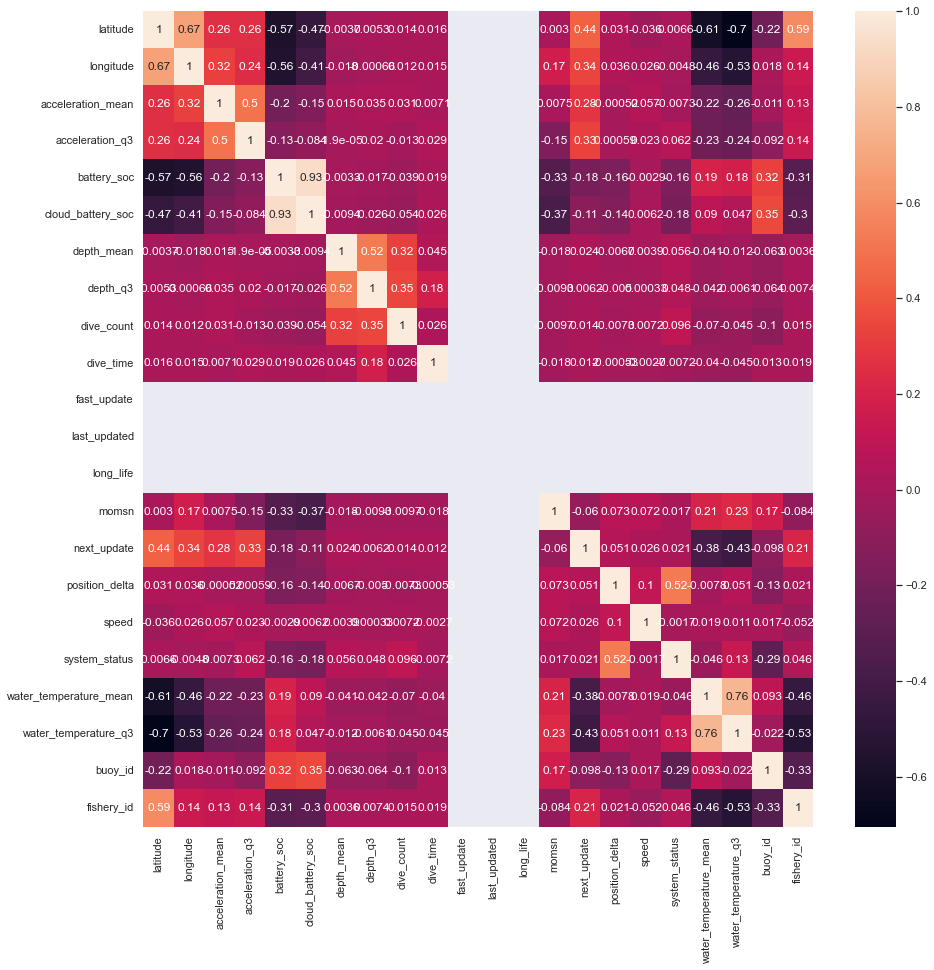

In [50]:
corr_filtered = filtered_buoys.corr()
sb.set(rc = {'figure.figsize':(15,15)})
sb.heatmap(corr, annot = True)

In [51]:
filtered_buoys.isnull().sum()

datetime                      0
latitude                      0
longitude                     0
acceleration_mean             0
acceleration_q3               0
battery_soc                   0
cloud_battery_soc             0
depth_mean                    0
depth_q3                      0
dive_count                    0
dive_time                     0
fast_update               29809
last_updated              29809
long_life                 29809
momsn                         0
next_update                   0
position_delta                0
speed                         0
system_status                 0
water_temperature_mean        0
water_temperature_q3          0
buoy_id                       0
fishery_id                    0
location                      0
catch                         0
gear                          0
date                          0
dtype: int64

In [52]:
filtered_buoys.dtypes

datetime                  datetime64[ns]
latitude                         float64
longitude                        float64
acceleration_mean                float64
acceleration_q3                  float64
battery_soc                      float64
cloud_battery_soc                float64
depth_mean                       float64
depth_q3                         float64
dive_count                       float64
dive_time                        float64
fast_update                      float64
last_updated                     float64
long_life                        float64
momsn                              int64
next_update                        int64
position_delta                   float64
speed                            float64
system_status                    float64
water_temperature_mean           float64
water_temperature_q3             float64
buoy_id                            int64
fishery_id                         int64
location                          object
catch           

##### Messages by Buoy

In [53]:
fig = px.histogram(filtered_buoys, x = 'buoy_id')
fig.update_layout(bargap = 0.2)
fig.show()

##### Analyze messages over time

In [54]:
min_date = filtered_buoys['date'].min()
max_date = filtered_buoys['date'].max()
display(HTML(f"<ul><li>the date range is between {min_date} and {max_date}, inclusive.</li><ul>"))

In [55]:
fig = px.histogram(filtered_buoys , x = 'date')
fig.update_layout(bargap = 0.2)
fig.show()

##### Messages by Geography

In [56]:
# Determine approximate "bounding box" of all buoys' latitude and longitude
desc_stats = filtered_buoys.describe()
lat_col = 'latitude'
lon_col = 'longitude'

southwest = (desc_stats[lat_col]['min'], desc_stats[lon_col]['min'])
southeast = (desc_stats[lat_col]['min'], desc_stats[lon_col]['max'])
northwest = (desc_stats[lat_col]['max'], desc_stats[lon_col]['min'])
northeast = (desc_stats[lat_col]['max'], desc_stats[lon_col]['max'])

print("Bounding Box")
print(f"Northwest: {northwest}")
print(f"Northeast: {northeast}")
print(f"Southwest: {southwest}")
print(f"Southeast: {southeast}")

Bounding Box
Northwest: (49.237, -77.59464)
Northeast: (49.237, -58.327663)
Southwest: (31.891788, -77.59464)
Southeast: (31.891788, -58.327663)


In [57]:
# Plot all buoy measurements with bounding box
corners = [northeast, northwest, southwest, southeast, northeast]
corner_lats = [c[0] for c in corners]
corner_lons = [c[1] for c in corners]

fig = go.Figure(go.Scattermapbox(
    name = "Bounding Box",
    mode = "markers+lines",
    lon = corner_lons,
    lat = corner_lats,
    marker = {'size': 1},
    line={"color": "yellow"}))

fig.add_trace(go.Scattermapbox(
    name = "Buoy Locations",
    mode = "markers",
    lon = buoy_df['longitude'],
    lat = buoy_df['latitude'],
    marker = {'size': 5},
    hovertext = filtered_buoys['buoy_id'].apply(lambda id: f"Buoy {id}")))

fig.update_layout(
    margin ={'l':0,'t':0,'b':0,'r':0},
    mapbox = {
        'center': {'lon': 10, 'lat': 10},
        'style': "stamen-terrain",
        'center': {'lon': -126, 'lat': 44},
        'zoom': 2})

fig.show()

##### Message by Fishery

In [241]:
fishery_df = fishery_df.rename(columns = {'id':'fishery_id'})
#merge fishery_df with buoy_fisher_df by fishery_id
buoy_fishery_df_new = pd.merge(fishery_df, buoy_fishery_df, on='fishery_id')
buoy_df = filtered_buoys.rename(columns = {"sensor_id":"buoy_id"})
#merge all three dataframes
buoy_fishery_df_all_filtered = pd.merge(buoy_fishery_df_new, filtered_buoys, on = 'buoy_id')

In [64]:
group_fishery = buoy_fishery_df_all_filtered.groupby('catch')

In [65]:
messagebyfishery('Lobster')

(None, None, None)

In [66]:
messagebyfishery('Snow crab')

(None, None, None)

In [67]:
messagebyfishery('Swordfish')

(None, None, None)

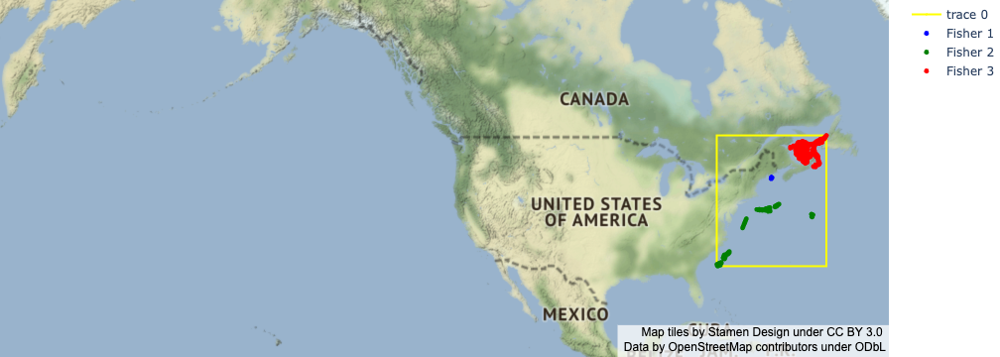

In [68]:
map_fisher_points(buoy_fishery_df_all_filtered)

##### Buoy Deployments

In [46]:
# Sort the buoy data points by buoy_id and timestamp (so each buoy is organized sequentially)
filtered_buoys = filtered_buoys.sort_values(by=['buoy_id', 'datetime']).reset_index(drop=True)
deployment_num = 0

# Deployment number increments at each location where system status equals 'Entered Water'
for index, row in filtered_buoys.iterrows():
    if row['system_status_interpret'] == 'Entered Water':
        deployment_num += 1

    # Check to ensure that in case a buoy is placed in water without reporting 'Entered Water'
    elif row['system_status_interpret'] != 'Entered Water' and index >= 1:
        if row['buoy_id'] != filtered_buoys.loc[index-1]['buoy_id']:
            deployment_num += 1

    filtered_buoys.at[index, 'deployment_id'] = deployment_num

KeyError: 'system_status_interpret'

In [71]:
deployment_num #2156 deployments occurred

2156

In [72]:
filtered_buoys.groupby(['buoy_id'])['deployment_id'].nunique() #deployment per buoy 

buoy_id
103    22
104    14
105     7
107    14
108    16
       ..
590    14
674    29
678    35
679    30
680    32
Name: deployment_id, Length: 158, dtype: int64

How long did each deployment last?

In [73]:
temp_filtered = (filtered_buoys
  .groupby(["deployment_id"])[['datetime']]
  .agg(['first', 'last'])
  .groupby(["deployment_id"])
  .apply(get_cols)
  .to_frame()
  .reset_index()
  .rename(columns={0:'time_info'}))

temp[['set_on', 'hauled_on', 'duration']] = pd.DataFrame(temp_filtered['time_info'].tolist(), index=temp_filtered.index)
deployments_df_filtered = temp[['deployment_id', 'set_on', 'hauled_on', 'duration']]
deployments_df_filtered = deployments_df_filtered.merge(
    right=filtered_buoys[['deployment_id']],
    on='deployment_id',
    how='left')
#deployments_df.drop_duplicates(inplace=True)
deployments_df_filtered

,deployment_id,set_on,hauled_on,duration
0,1.0,2022-04-13 21:23:06,2022-04-14 18:38:10,0 days 21:15:04
1,1.0,2022-04-13 21:23:06,2022-04-14 18:38:10,0 days 21:15:04
2,1.0,2022-04-13 21:23:06,2022-04-14 18:38:10,0 days 21:15:04
3,1.0,2022-04-13 21:23:06,2022-04-14 18:38:10,0 days 21:15:04
4,1.0,2022-04-13 21:23:06,2022-04-14 18:38:10,0 days 21:15:04
...,...,...,...,...
30513,2839.0,NaT,NaT,NaT
30514,2840.0,NaT,NaT,NaT
30515,2841.0,NaT,NaT,NaT
30516,2842.0,NaT,NaT,NaT


How many messages in each deployment

In [74]:
filtered_buoys.groupby(['deployment_id']).count()[['momsn']].rename(columns={"momsn": "num_messages"}).sort_values("num_messages")

,num_messages
deployment_id,
426.0,1
224.0,1
1140.0,1
1139.0,1
1773.0,1
...,...
406.0,753
1352.0,829
1963.0,941


### Preliminary Buoy Motion Analysis

#### Calculate Buoy Deployments' Smallest Enclosing Circles 
For each buoy deployment, generate the smallest circle that encloses all of the plotted messages in that deployment

In [168]:
buoy_fishery_df_all_filtered.head()

,fishery_id,location,catch,gear,buoy_id,datetime,latitude,longitude,acceleration_mean,acceleration_q3,...,position_delta,speed,system_status,water_temperature_mean,water_temperature_q3,date,system_status_int,system_status_cat,system_status_interpret,deployment_id
0,1,Maine,Lobster,Single-line pots,587,2022-07-29 11:52:36,44.139910,-68.07895,1.058633,1.847956,...,0.0,1.34,1557.0,18.0,18.0,2022-07-29,1557,"[in_water, update_reason_sws, update_reason_sc...",Entered Water,2622.0
1,1,Maine,Lobster,Single-line pots,587,2022-07-30 11:52:27,44.140965,-68.08015,0.316944,3.173344,...,131.0,0.21,1045.0,14.0,16.0,2022-07-30,1045,"[in_water, update_reason_scheduled]",Scheduled,2622.0
2,1,Maine,Lobster,Single-line pots,587,2022-07-31 11:52:27,44.140686,-68.07978,0.357543,3.381208,...,86.0,0.20,1045.0,13.0,16.0,2022-07-31,1045,"[in_water, update_reason_scheduled]",Scheduled,2622.0
3,1,Maine,Lobster,Single-line pots,587,2022-08-01 11:53:27,44.140000,-68.07970,0.407353,2.727215,...,29.0,0.34,1045.0,14.0,15.0,2022-08-01,1045,"[in_water, update_reason_scheduled]",Scheduled,2622.0
4,1,Maine,Lobster,Single-line pots,587,2022-08-02 11:53:47,44.140100,-68.07975,0.437670,3.735818,...,32.0,0.78,1045.0,13.0,16.0,2022-08-02,1045,"[in_water, update_reason_scheduled]",Scheduled,2622.0


#### Method1: Treating coordinates as XY points

In [71]:
def calculate_all_circles(df, deployment_col = 'deployment_id'):
    """
    """
    circles = {}
    for deployment_id in set(df[deployment_col]):
        single_deployment = df[df[deployment_col] == deployment_id]
        buoy_points = single_deployment[['longitude','latitude']]
        buoy_points = buoy_points.to_records(index=False)
        buoy_points = list(buoy_points)
        circle = ec.make_circle(buoy_points)
        circles[deployment_id] = {'buoy_id': int(max(single_deployment['buoy_id'])), 'deployment_id': deployment_id, 'first_reading': min(single_deployment['datetime']), 'last_reading': max(single_deployment['datetime']), 'circle_center_lon': circle[0],'circle_center_lat': circle[1],'circle_radius': circle[2], 'num_readings': len(single_deployment), 'max_acceleration': max(single_deployment['acceleration_q3']), 'max_divetime': max(single_deployment['dive_time']), 'first_momsn': min(single_deployment['momsn']), 'last_momsn': max(single_deployment['momsn'])}
    return circles


In [72]:
all_circles = calculate_all_circles(filtered_buoys, 'deployment_id')
all_circles_df = (pd.DataFrame
                  .from_dict(all_circles)
                  .T
                  .sort_values(by=['circle_radius', 'num_readings'], ascending=False))
all_circles_df.head(2)

,buoy_id,deployment_id,first_reading,last_reading,circle_center_lon,circle_center_lat,circle_radius,num_readings,max_acceleration,max_divetime,first_momsn,last_momsn
1963.0,577,1963.0,2022-05-11 08:15:42,2022-07-20 18:16:29,-61.385464,47.936651,2.472035,941,7.835812,0.0,65,1006
406.0,460,406.0,2022-05-15 12:02:46,2022-07-10 08:09:36,-60.324715,47.868325,2.413964,753,13.355459,0.0,76,831


In [73]:
all_circles_df = pd.DataFrame.from_dict(all_circles).T.sort_values(by= ['circle_radius', 'num_readings'], ascending=False)
all_circles_df['circle_radius_in_km'] = all_circles_df['circle_radius'] * 99.5
all_circles_df['circle_radius_in_m'] = all_circles_df['circle_radius_in_km'] * 1000
all_circles_df

,buoy_id,deployment_id,first_reading,last_reading,circle_center_lon,circle_center_lat,circle_radius,num_readings,max_acceleration,max_divetime,first_momsn,last_momsn,circle_radius_in_km,circle_radius_in_m
1963.0,577,1963.0,2022-05-11 08:15:42,2022-07-20 18:16:29,-61.385464,47.936651,2.472035,941,7.835812,0.0,65,1006,245.967513,245967.51349
406.0,460,406.0,2022-05-15 12:02:46,2022-07-10 08:09:36,-60.324715,47.868325,2.413964,753,13.355459,0.0,76,831,240.189442,240189.441837
1548.0,546,1548.0,2022-05-03 00:23:07,2022-06-18 11:37:06,-61.087663,46.644822,1.72897,1052,19.33511,0.0,46,1100,172.032492,172032.491882
1564.0,547,1564.0,2022-06-20 12:00:16,2022-06-20 17:15:10,-63.37343,47.97667,1.36076,5,1.126925,0.0,157,161,135.395628,135395.627637
1571.0,548,1571.0,2022-05-07 10:52:24,2022-07-07 09:04:36,-62.590063,47.882881,0.981702,988,12.46756,0.0,59,1054,97.679393,97679.392629
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1140.0,513,1140.0,2022-04-21 23:00:45,2022-04-21 23:00:45,-62.501392,47.51992,0.0,1,1.839994,0.0,21,21,0.0,0.0
1521.0,542,1521.0,2022-06-05 01:51:45,2022-06-05 01:51:45,-62.55567,47.82382,0.0,1,0.175589,0.0,122,122,0.0,0.0
1771.0,562,1771.0,2022-06-20 07:20:27,2022-06-20 07:20:27,-63.510025,48.05094,0.0,1,0.729023,0.0,184,184,0.0,0.0
1773.0,562,1773.0,2022-06-20 10:51:23,2022-06-20 10:51:23,-64.19152,48.028633,0.0,1,0.480105,0.0,187,187,0.0,0.0


#### Method 2: Converting coordinates to UTM grid points

In [74]:
from typing import List, Dict, Tuple
import utm
def calculate_all_circles_utm(
    df: pd.DataFrame,
    deployment_col: str='deployment_id') -> List[Dict]:
    """
    For each buoy deployment group in the DataFrame, converts
    each point's latitude and longitude coordinates into UTM
    (Universal Transverse Mercator) grid coordinates. Then draws
    the smallest enclosing circle around the grid coordinates,
    converting the circle's center back to lat/lon in the final
    step.

    Paramters:
        deployment_col (str): The name of the column with
            the deployment identifier.

    Returns:
        (Dict): A dictionary holding computed circle
            information for each deployment, including
            the circle radius in meters and the circle
            center in latitude and longitude.

    References:
    - https://pubs.usgs.gov/fs/2001/0077/report.pdf
    """
    
    # Define local function
    def _lat_lon_to_utm_coords(row: pd.Series) -> Tuple[int, int, str, str]:
        """
        Local function to produce a tuple of UTM
        coordinates from a DataFrame row containing
        `position_latitude` and `position_longitude`
        columns.

        Parameters:
            row (pd.Series): A Pandas Series
                repesenting a row.

        Returns:
            (float, float, str, str): A four-item tuple
                consisting of the UTM x-coordinate,
                y-coordinate, zone number, and zone letter.
        """
        u = utm.from_latlon(row['latitude'], row['longitude'])
        x, y, zone_num, zone_letter = u
        return x, y, str(zone_num), str(zone_letter)

    # Generate circles
    circles = {}
    for deployment_id in set(df[deployment_col]):

        # Get messages for deployment
        single_deployment = df[df[deployment_col] == deployment_id]

        # Convert points to UTM coordinates (uses XY plane)
        buoy_points = single_deployment[['longitude','latitude']]
        buoy_points[['utm_x', 'utm_y', 'utm_zone_num', 'utm_zone_letter']] = (
            buoy_points.apply(
                 func=_lat_lon_to_utm_coords,
                 axis="columns",
                 result_type="expand"))
        
        # Set appropriate zone number and letter
        buoy_points['utm_zone'] = buoy_points['utm_zone_num'] + buoy_points['utm_zone_letter']
        unique_zones = buoy_points['utm_zone'].unique().tolist()

        if len(unique_zones) > 1:
            print(f"Warning - Deployment {deployment_id} has points "
                f"spanning more than one UTM zone: {', '.join(unique_zones)}.")
            max_zone = buoy_points.groupby('utm_zone').count().idxmax().iloc[0]
            first_row = buoy_points.query('`utm_zone` == @max_zone').head(1).iloc[0, :]
        else:
            first_row = buoy_points.iloc[0, :]

        zone_num = int(first_row['utm_zone_num'])
        zone_letter = first_row['utm_zone_letter']

        # Otherwise, prepare XY points for smallest circle calculation
        xy_points = buoy_points[['utm_x', 'utm_y']].to_records(index=False)
        
        # Run smallest enclosing circle algorithm
        circle = ec.make_circle(list(xy_points))

        # Convert circle results back to lat-long
        c_x, c_y, c_radius = circle
        c_lat, c_lon = utm.to_latlon(c_x, c_y, zone_num, zone_letter)

        # Aggregate results
        circles[deployment_id] = {
            'buoy_id': int(max(single_deployment['buoy_id'])),
            'deployment_id': deployment_id,
            'first_reading': min(single_deployment['datetime']),
            'last_reading': max(single_deployment['datetime']),
            'circle_center_lon': c_lon,
            'circle_center_lat': c_lat,
            'circle_radius_in_m': c_radius, 
            'num_readings': len(single_deployment),
            'max_acceleration': max(single_deployment['acceleration_q3']),
            'max_divetime': max(single_deployment['dive_time']),
            'first_momsn': min(single_deployment['momsn']),
            'last_momsn': max(single_deployment['momsn'])
        }

    return circles


In [75]:
import warnings
warnings.filterwarnings('ignore')

In [76]:
# Draw the smallest possible enclosing circle around each deployment group
# using UTM (Universal Transverse Mercator) grid coordinates
all_circles_utm = calculate_all_circles_utm(filtered_buoys, 'deployment_id')
all_circles_utm_df = (pd.DataFrame
                  .from_dict(all_circles_utm)
                  .T
                  .sort_values(
                      by=['circle_radius_in_m', 'num_readings'],
                      ascending=False))
all_circles_utm_df['circle_radius_in_km'] = all_circles_utm_df['circle_radius_in_m'] / 1000
all_circles_utm_df.head()

Warning - Deployment 406.0 has points spanning more than one UTM zone: 20T, 20U, 21U.
Warning - Deployment 697.0 has points spanning more than one UTM zone: 20T, 20U.
Warning - Deployment 1100.0 has points spanning more than one UTM zone: 20U, 20T.
Warning - Deployment 1352.0 has points spanning more than one UTM zone: 20T, 20U.
Warning - Deployment 1548.0 has points spanning more than one UTM zone: 20T, 21T.
Warning - Deployment 1564.0 has points spanning more than one UTM zone: 20U, 20T.
Warning - Deployment 1571.0 has points spanning more than one UTM zone: 20T, 20U.
Warning - Deployment 1963.0 has points spanning more than one UTM zone: 20T, 20U, 21U.
Warning - Deployment 2035.0 has points spanning more than one UTM zone: 19S, 19T.
Warning - Deployment 2038.0 has points spanning more than one UTM zone: 19S, 19T.
Warning - Deployment 2039.0 has points spanning more than one UTM zone: 19S, 19T.
Warning - Deployment 2042.0 has points spanning more than one UTM zone: 19S, 19T.
Warning 

,buoy_id,deployment_id,first_reading,last_reading,circle_center_lon,circle_center_lat,circle_radius_in_m,num_readings,max_acceleration,max_divetime,first_momsn,last_momsn,circle_radius_in_km
1548.0,546,1548.0,2022-05-03 00:23:07,2022-06-18 11:37:06,-62.997307,46.264149,241076.452366,1052,19.33511,0.0,46,1100,241.076452
406.0,460,406.0,2022-05-15 12:02:46,2022-07-10 08:09:36,-62.993522,47.88943,228895.364469,753,13.355459,0.0,76,831,228.895364
1963.0,577,1963.0,2022-05-11 08:15:42,2022-07-20 18:16:29,-63.002298,48.42722,221739.017557,941,7.835812,0.0,65,1006,221.739018
1564.0,547,1564.0,2022-06-20 12:00:16,2022-06-20 17:15:10,-63.375802,47.984691,101814.302688,5,1.126925,0.0,157,161,101.814303
105.0,111,105.0,2022-04-26 17:43:30,2022-05-16 23:00:04,-62.414613,46.676079,90105.946201,392,5.397608,0.0,41,435,90.105946


In [250]:
def plot_buoy_swing_range(buoys_df, circles_df, deployment_id):
    """
    """
  # Subset data to deployment
    points_subset = buoys_df.query("`deployment_id` == @deployment_id")
    circle_subset = circles_df.query("`deployment_id` == @deployment_id")

  # Get lat, lon, and radius or 
    circle_lon = circle_subset['circle_center_lon'].values[0]
    circle_lat = circle_subset['circle_center_lat'].values[0]
    circle_radius = circle_subset['circle_radius_in_m'].values[0]

  # Create map centered at smallest circle center
    m = folium.Map(location=[circle_lat, circle_lon], zoom_start=18)

  # Draw circle as first layer
    folium.Circle(
      radius=circle_radius,
      location=[circle_lat, circle_lon],
      color="yellow",
      fill=False
    ).add_to(m)

  # Draw circle center as second layer
    folium.Circle(
        radius=1,
        location=[circle_lat, circle_lon],
        color="yellow",
        fill=True,
        tooltip=f"<h4>Circle Center: ({circle_lat}, {circle_lon})</h4>"
  ).add_to(m)

  # Draw points as third layer
    for i, pt in points_subset[[
        'buoy_id',
        'latitude',
        'longitude',
        'datetime',
        'fishery_id']].iterrows():

        buoy_id, lat, lon, timestamp, fisher = pt
        tooltip = f'''
            <div>
            <h4>Buoy {buoy_id}</h4>
            <h5>Location: ({lat}, {lon})<h5>
            <h5>Timestamp: {timestamp}</h5>
            <h5>Fisher: {fisher}</h5>
          </div>
    '''

    folium.CircleMarker(
        location=[lat, lon],
        radius=1,
        fill=True,
        tooltip=tooltip).add_to(m)

  # Display map
    return m

In [ ]:
for d_id in [1, 3, 6, 8, 15, 11, 12, 22, 45, 121]:
    display(HTML(f"<h3>Deployment {d_id} - Straight Euclidean</h3>"))
    display(plot_buoy_swing_range(filtered_buoys, all_circles_df, deployment_id=d_id))
    display(HTML(f"<h3>Deployment {d_id} - UTM Conversion</h3>"))
    display(plot_buoy_swing_range(filtered_buoys, all_circles_utm_df, deployment_id=d_id))

In [242]:
buoy_fishery_df_all_filtered.head()

,fishery_id,location,catch,gear,buoy_id,datetime,latitude,longitude,acceleration_mean,acceleration_q3,...,position_delta,speed,system_status,water_temperature_mean,water_temperature_q3,date,system_status_int,system_status_cat,system_status_interpret,deployment_id
0,1,Maine,Lobster,Single-line pots,587,2022-07-29 11:52:36,44.139910,-68.07895,1.058633,1.847956,...,0.0,1.34,1557.0,18.0,18.0,2022-07-29,1557,"[in_water, update_reason_sws, update_reason_sc...",Entered Water,2622.0
1,1,Maine,Lobster,Single-line pots,587,2022-07-30 11:52:27,44.140965,-68.08015,0.316944,3.173344,...,131.0,0.21,1045.0,14.0,16.0,2022-07-30,1045,"[in_water, update_reason_scheduled]",Scheduled,2622.0
2,1,Maine,Lobster,Single-line pots,587,2022-07-31 11:52:27,44.140686,-68.07978,0.357543,3.381208,...,86.0,0.20,1045.0,13.0,16.0,2022-07-31,1045,"[in_water, update_reason_scheduled]",Scheduled,2622.0
3,1,Maine,Lobster,Single-line pots,587,2022-08-01 11:53:27,44.140000,-68.07970,0.407353,2.727215,...,29.0,0.34,1045.0,14.0,15.0,2022-08-01,1045,"[in_water, update_reason_scheduled]",Scheduled,2622.0
4,1,Maine,Lobster,Single-line pots,587,2022-08-02 11:53:47,44.140100,-68.07975,0.437670,3.735818,...,32.0,0.78,1045.0,13.0,16.0,2022-08-02,1045,"[in_water, update_reason_scheduled]",Scheduled,2622.0


In [243]:
buoy_filtered_df = buoy_fishery_df_all_filtered

In [245]:
buoy_filtered_df['datetime'] = pd.to_datetime(buoy_filtered_df['datetime'])
buoy_filtered_df['date'] = buoy_filtered_df['datetime'].dt.date
buoy_filtered_df = buoy_filtered_df.sort_values('date', ascending=True)

In [252]:
buoy_filtered_df

NameError: name 'buoy_filtered_df' is not defined

In [249]:
all_circles_df

,buoy_id,deployment_id,first_reading,last_reading,circle_center_lon,circle_center_lat,circle_radius,num_readings,max_acceleration,max_divetime,first_momsn,last_momsn,circle_radius_in_km,circle_radius_in_m
2580.0,577,2580.0,2022-05-11 08:15:42,2022-07-20 18:16:29,-61.385464,47.936651,2.472035,941,7.835812,0.0,65,1006,245.967513,245967.51349
649.0,460,649.0,2022-05-15 12:02:46,2022-07-10 08:09:36,-60.324715,47.868325,2.413964,753,13.355459,0.0,76,831,240.189442,240189.441837
2002.0,546,2002.0,2022-05-03 00:23:07,2022-06-18 11:37:06,-61.087663,46.644822,1.72897,1052,19.33511,0.0,46,1100,172.032492,172032.491882
2024.0,547,2024.0,2022-06-20 12:00:16,2022-06-20 17:15:10,-63.37343,47.97667,1.36076,5,1.126925,0.0,157,161,135.395628,135395.627637
2037.0,548,2037.0,2022-05-07 10:52:24,2022-07-07 09:04:36,-62.590063,47.882881,0.981702,988,12.46756,0.0,59,1054,97.679393,97679.392629
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1519.0,513,1519.0,2022-04-21 23:00:45,2022-04-21 23:00:45,-62.501392,47.51992,0.0,1,1.839994,0.0,21,21,0.0,0.0
1959.0,542,1959.0,2022-06-05 01:51:45,2022-06-05 01:51:45,-62.55567,47.82382,0.0,1,0.175589,0.0,122,122,0.0,0.0
2310.0,562,2310.0,2022-06-20 07:20:27,2022-06-20 07:20:27,-63.510025,48.05094,0.0,1,0.729023,0.0,184,184,0.0,0.0
2312.0,562,2312.0,2022-06-20 10:51:23,2022-06-20 10:51:23,-64.19152,48.028633,0.0,1,0.480105,0.0,187,187,0.0,0.0


In [254]:
for d_id in [1548.0, 406.0, 1936.0, 1564.0,105.0, 562.0, 349.0]:
    #display(HTML(f"<h3>Deployment {d_id} - Straight Euclidean</h3>"))
    #display(plot_buoy_swing_range(buoy_filtered_df, all_circles_df, deployment_id=d_id))
    display(HTML(f"<h3>Deployment {d_id} - UTM Conversion</h3>"))
    display(plot_buoy_swing_range(filtered_buoys, all_circles_utm_df, deployment_id=d_id))

In [255]:
all_circles_utm_df[:2000]

,buoy_id,deployment_id,first_reading,last_reading,circle_center_lon,circle_center_lat,circle_radius_in_m,num_readings,max_acceleration,max_divetime,first_momsn,last_momsn,circle_radius_in_km
1548.0,546,1548.0,2022-05-03 00:23:07,2022-06-18 11:37:06,-62.997307,46.264149,241076.452366,1052,19.33511,0.0,46,1100,241.076452
406.0,460,406.0,2022-05-15 12:02:46,2022-07-10 08:09:36,-62.993522,47.88943,228895.364469,753,13.355459,0.0,76,831,228.895364
1963.0,577,1963.0,2022-05-11 08:15:42,2022-07-20 18:16:29,-63.002298,48.42722,221739.017557,941,7.835812,0.0,65,1006,221.739018
1564.0,547,1564.0,2022-06-20 12:00:16,2022-06-20 17:15:10,-63.375802,47.984691,101814.302688,5,1.126925,0.0,157,161,101.814303
105.0,111,105.0,2022-04-26 17:43:30,2022-05-16 23:00:04,-62.414613,46.676079,90105.946201,392,5.397608,0.0,41,435,90.105946
...,...,...,...,...,...,...,...,...,...,...,...,...,...
349.0,130,349.0,2022-04-26 12:30:06,2022-05-04 15:33:15,-62.534847,47.468369,124.617635,17,18.782671,0.0,33,51,0.124618
1360.0,530,1360.0,2022-04-26 16:16:16,2022-05-04 17:05:06,-62.597081,47.449798,124.533971,17,14.670698,0.0,26,43,0.124534
702.0,480,702.0,2022-05-03 03:29:07,2022-05-07 08:30:16,-62.57644,47.335163,124.360871,11,5.548104,0.0,43,53,0.124361
1843.0,569,1843.0,2022-04-21 21:23:17,2022-04-27 13:50:04,-62.466721,47.598802,124.229015,8,20.97496,0.0,24,31,0.124229


### Analyze Buoys' Range of Motion

In [93]:
all_circles_utm_df['circle_radius_in_km'].mean()

1.261280310253166

In [239]:
display(HTML(f"<h4>Swing Range Across Deployments (Histogram)</h4>"))
fig = px.histogram(all_circles_utm_df, x="circle_radius_in_km")
fig.update_layout(bargap=0.2, xaxis_range=[0,40])

fig.show()

In [94]:
len(all_circles_utm_df.query("`circle_radius_in_km` == 0"))

93

In [233]:
all_circles_utm_df.head(50)

,buoy_id,deployment_id,first_reading,last_reading,circle_center_lon,circle_center_lat,circle_radius_in_m,num_readings,max_acceleration,max_divetime,first_momsn,last_momsn,circle_radius_in_km
1548.0,546,1548.0,2022-05-03 00:23:07,2022-06-18 11:37:06,-62.997307,46.264149,241076.452366,1052,19.33511,0.0,46,1100,241.076452
406.0,460,406.0,2022-05-15 12:02:46,2022-07-10 08:09:36,-62.993522,47.88943,228895.364469,753,13.355459,0.0,76,831,228.895364
1963.0,577,1963.0,2022-05-11 08:15:42,2022-07-20 18:16:29,-63.002298,48.42722,221739.017557,941,7.835812,0.0,65,1006,221.739018
1564.0,547,1564.0,2022-06-20 12:00:16,2022-06-20 17:15:10,-63.375802,47.984691,101814.302688,5,1.126925,0.0,157,161,101.814303
105.0,111,105.0,2022-04-26 17:43:30,2022-05-16 23:00:04,-62.414613,46.676079,90105.946201,392,5.397608,0.0,41,435,90.105946
1352.0,529,1352.0,2022-05-11 06:55:49,2022-06-27 20:40:20,-62.614022,47.438238,84385.648713,829,10.685657,0.0,61,891,84.385649
1571.0,548,1571.0,2022-05-07 10:52:24,2022-07-07 09:04:36,-62.58075,47.938371,78608.922007,988,12.46756,0.0,59,1054,78.608922
1284.0,524,1284.0,2022-05-20 13:36:46,2022-06-02 13:45:06,-62.262904,47.055213,71493.133772,287,12.985987,0.0,84,370,71.493134
1391.0,532,1391.0,2022-04-22 11:26:06,2022-05-06 09:56:20,-62.756574,47.028225,67093.9001,227,19.961653,39602.0,23,250,67.0939
1828.0,567,1828.0,2022-04-22 12:16:46,2022-05-06 15:10:08,-62.786178,47.000248,61465.217628,218,11.387828,0.0,22,240,61.465218


In [162]:
import numpy as np
outlier1 = np.mean(all_circles_utm_df['circle_radius_in_km']) + 2 * np.std(all_circles_utm_df['circle_radius_in_km'])
outlier2 = np.mean(all_circles_utm_df['circle_radius_in_km']) - 2 * np.std(all_circles_utm_df['circle_radius_in_km'])


In [155]:
filtered_all_circles_utm_df = all_circles_utm_df[(all_circles_utm_df['circle_radius_in_km'] != 0.0) &(all_circles_utm_df['circle_radius_in_km'] < outlier1) & (all_circles_utm_df['circle_radius_in_km'] > outlier2) ]
#filtered_all_circles_utm_df = all_circles_utm_df[(all_circles_utm_df['circle_radius_in_km'] < outlier1) & (all_circles_utm_df['circle_radius_in_km'] > outlier2)]

In [156]:
filtered_all_circles_utm_df

,buoy_id,deployment_id,first_reading,last_reading,circle_center_lon,circle_center_lat,circle_radius_in_m,num_readings,max_acceleration,max_divetime,first_momsn,last_momsn,circle_radius_in_km
2097.0,679,2097.0,2022-06-20 23:37:16,2022-06-21 15:10:04,-75.673863,33.725946,20747.724732,17,1.975813,0.0,109,125,20.747725
1390.0,532,1390.0,2022-04-22 08:00:16,2022-04-22 11:20:12,-62.859489,47.494068,20384.48275,3,3.232022,0.0,20,22,20.384483
2126.0,680,2126.0,2022-06-19 02:21:30,2022-06-19 15:30:04,-77.114396,32.181756,20285.762407,14,3.287643,0.0,88,101,20.285762
2050.0,674,2050.0,2022-08-13 23:58:17,2022-08-14 17:40:04,-68.387714,39.83095,19205.009649,19,3.387715,0.0,388,406,19.20501
2034.0,674,2034.0,2022-06-21 00:22:16,2022-06-21 16:10:04,-75.654719,33.693093,19035.747439,17,3.066284,0.0,149,165,19.035747
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1551.0,546,1551.0,2022-06-19 02:06:17,2022-06-19 06:40:04,-60.235538,45.718244,5.206556,3,0.281568,0.0,1108,1110,0.005207
399.0,307,399.0,2022-06-23 14:20:06,2022-06-24 12:21:04,-64.54557,47.811631,5.081113,4,3.710778,0.0,156,159,0.005081
1441.0,536,1441.0,2022-05-02 01:24:06,2022-05-03 16:15:10,-61.978495,46.454833,4.129487,6,0.199099,0.0,196,201,0.004129
112.0,111,112.0,2022-05-17 12:16:07,2022-05-18 12:43:20,-62.510027,46.172933,2.507461,2,0.195377,0.0,449,450,0.002507


In [157]:
filtered_all_circles_utm_df.sort_values(by="circle_radius_in_km")

,buoy_id,deployment_id,first_reading,last_reading,circle_center_lon,circle_center_lat,circle_radius_in_m,num_readings,max_acceleration,max_divetime,first_momsn,last_momsn,circle_radius_in_km
106.0,111,106.0,2022-05-16 23:05:54,2022-05-17 01:05:04,-62.509705,46.172829,1.221447,2,5.473105,0.0,436,437,0.001221
112.0,111,112.0,2022-05-17 12:16:07,2022-05-18 12:43:20,-62.510027,46.172933,2.507461,2,0.195377,0.0,449,450,0.002507
1441.0,536,1441.0,2022-05-02 01:24:06,2022-05-03 16:15:10,-61.978495,46.454833,4.129487,6,0.199099,0.0,196,201,0.004129
399.0,307,399.0,2022-06-23 14:20:06,2022-06-24 12:21:04,-64.54557,47.811631,5.081113,4,3.710778,0.0,156,159,0.005081
1551.0,546,1551.0,2022-06-19 02:06:17,2022-06-19 06:40:04,-60.235538,45.718244,5.206556,3,0.281568,0.0,1108,1110,0.005207
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2034.0,674,2034.0,2022-06-21 00:22:16,2022-06-21 16:10:04,-75.654719,33.693093,19035.747439,17,3.066284,0.0,149,165,19.035747
2050.0,674,2050.0,2022-08-13 23:58:17,2022-08-14 17:40:04,-68.387714,39.83095,19205.009649,19,3.387715,0.0,388,406,19.20501
2126.0,680,2126.0,2022-06-19 02:21:30,2022-06-19 15:30:04,-77.114396,32.181756,20285.762407,14,3.287643,0.0,88,101,20.285762
1390.0,532,1390.0,2022-04-22 08:00:16,2022-04-22 11:20:12,-62.859489,47.494068,20384.48275,3,3.232022,0.0,20,22,20.384483


In [159]:
filtered_all_circles_utm_df = filtered_all_circles_utm_df[filtered_all_circles_utm_df['circle_radius_in_km'] < 0.3]

In [160]:
filtered_all_circles_utm_df

,buoy_id,deployment_id,first_reading,last_reading,circle_center_lon,circle_center_lat,circle_radius_in_m,num_readings,max_acceleration,max_divetime,first_momsn,last_momsn,circle_radius_in_km
1335.0,528,1335.0,2022-05-04 06:35:44,2022-05-08 11:51:08,-62.558787,47.769917,299.521596,13,9.886049,0.0,43,55,0.299522
515.0,467,515.0,2022-05-07 09:05:35,2022-05-11 06:40:18,-62.564638,47.3519,285.065184,12,4.385366,0.0,58,69,0.285065
1835.0,568,1835.0,2022-05-20 16:15:46,2022-05-24 13:10:08,-62.436001,47.622098,284.769901,11,7.141804,0.0,85,95,0.28477
1053.0,506,1053.0,2022-04-21 20:30:46,2022-04-27 11:40:18,-62.526249,47.663887,284.229197,10,10.903811,0.0,16,25,0.284229
1209.0,519,1209.0,2022-04-21 20:32:46,2022-04-26 03:35:14,-62.517367,47.659275,276.7252,9,15.236082,0.0,20,28,0.276725
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1551.0,546,1551.0,2022-06-19 02:06:17,2022-06-19 06:40:04,-60.235538,45.718244,5.206556,3,0.281568,0.0,1108,1110,0.005207
399.0,307,399.0,2022-06-23 14:20:06,2022-06-24 12:21:04,-64.54557,47.811631,5.081113,4,3.710778,0.0,156,159,0.005081
1441.0,536,1441.0,2022-05-02 01:24:06,2022-05-03 16:15:10,-61.978495,46.454833,4.129487,6,0.199099,0.0,196,201,0.004129
112.0,111,112.0,2022-05-17 12:16:07,2022-05-18 12:43:20,-62.510027,46.172933,2.507461,2,0.195377,0.0,449,450,0.002507


In [161]:
display(HTML(f"<h4>New Swing Range Across Deployments (Histogram)</h4>"))
fig = px.histogram(filtered_all_circles_utm_df, x="circle_radius_in_km")
fig.update_layout(bargap=0.2)
fig.show()

In [163]:
filtered_all_circles_utm_df['circle_radius_in_km'].mean()

0.09959829935042905

#### radius by fishery

In [164]:
filtered_all_circles_utm_df.columns

Index(['buoy_id', 'deployment_id', 'first_reading', 'last_reading',
       'circle_center_lon', 'circle_center_lat', 'circle_radius_in_m',
       'num_readings', 'max_acceleration', 'max_divetime', 'first_momsn',
       'last_momsn', 'circle_radius_in_km'],
      dtype='object')

In [168]:
filtered_buoys.head()

,datetime,latitude,longitude,acceleration_mean,acceleration_q3,battery_soc,cloud_battery_soc,depth_mean,depth_q3,dive_count,...,buoy_id,fishery_id,location,catch,gear,date,system_status_int,system_status_cat,system_status_interpret,deployment_id
0,2022-04-13 21:23:06,47.484776,-63.311108,0.413450,0.638865,48.0,64.0,0.0,0.0,0.0,...,103,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2022-04-13,1557,"[in_water, update_reason_sws, update_reason_sc...",Entered Water,1.0
1,2022-04-13 22:23:36,47.484440,-63.311733,0.524319,1.103890,48.0,64.0,0.0,0.0,0.0,...,103,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2022-04-13,33556501,"[in_water, update_reason_moved]",Moved,1.0
2,2022-04-13 23:23:36,47.484764,-63.311810,0.345631,1.103890,48.0,64.0,0.0,0.0,0.0,...,103,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2022-04-13,33556501,"[in_water, update_reason_moved]",Moved,1.0
3,2022-04-14 00:23:36,47.484920,-63.311733,0.230597,1.103890,48.0,64.0,0.0,0.0,0.0,...,103,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2022-04-14,33556501,"[in_water, update_reason_moved]",Moved,1.0
4,2022-04-14 01:23:36,47.485010,-63.311676,0.350084,1.103890,47.0,64.0,0.0,0.0,0.0,...,103,3,New Brunswick/Gulf of St. Lawrence,Snow crab,Single-line pots,2022-04-14,33556501,"[in_water, update_reason_moved]",Moved,1.0


In [179]:

fishery_loc_df = filtered_buoys.groupby(['deployment_id']).first()[['location']].rename(columns = {"location":"fishery"}).reset_index()
fishery_loc_df

,deployment_id,fishery
0,1.0,New Brunswick/Gulf of St. Lawrence
1,2.0,New Brunswick/Gulf of St. Lawrence
2,3.0,New Brunswick/Gulf of St. Lawrence
3,4.0,New Brunswick/Gulf of St. Lawrence
4,5.0,New Brunswick/Gulf of St. Lawrence
...,...,...
2151,2152.0,Massachusetts
2152,2153.0,Massachusetts
2153,2154.0,Massachusetts
2154,2155.0,Massachusetts


In [173]:
filtered_all_circles_utm_df

,buoy_id,deployment_id,first_reading,last_reading,circle_center_lon,circle_center_lat,circle_radius_in_m,num_readings,max_acceleration,max_divetime,first_momsn,last_momsn,circle_radius_in_km
1335.0,528,1335.0,2022-05-04 06:35:44,2022-05-08 11:51:08,-62.558787,47.769917,299.521596,13,9.886049,0.0,43,55,0.299522
515.0,467,515.0,2022-05-07 09:05:35,2022-05-11 06:40:18,-62.564638,47.3519,285.065184,12,4.385366,0.0,58,69,0.285065
1835.0,568,1835.0,2022-05-20 16:15:46,2022-05-24 13:10:08,-62.436001,47.622098,284.769901,11,7.141804,0.0,85,95,0.28477
1053.0,506,1053.0,2022-04-21 20:30:46,2022-04-27 11:40:18,-62.526249,47.663887,284.229197,10,10.903811,0.0,16,25,0.284229
1209.0,519,1209.0,2022-04-21 20:32:46,2022-04-26 03:35:14,-62.517367,47.659275,276.7252,9,15.236082,0.0,20,28,0.276725
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1551.0,546,1551.0,2022-06-19 02:06:17,2022-06-19 06:40:04,-60.235538,45.718244,5.206556,3,0.281568,0.0,1108,1110,0.005207
399.0,307,399.0,2022-06-23 14:20:06,2022-06-24 12:21:04,-64.54557,47.811631,5.081113,4,3.710778,0.0,156,159,0.005081
1441.0,536,1441.0,2022-05-02 01:24:06,2022-05-03 16:15:10,-61.978495,46.454833,4.129487,6,0.199099,0.0,196,201,0.004129
112.0,111,112.0,2022-05-17 12:16:07,2022-05-18 12:43:20,-62.510027,46.172933,2.507461,2,0.195377,0.0,449,450,0.002507


In [194]:
# Join swing radius with fisher informatino
fisher_info = (fishery_loc_df[['deployment_id', 'fishery']]
                .drop_duplicates()
                .set_index("deployment_id"))
swing_radius_df = filtered_all_circles_utm_df.join(fisher_info)
swing_radius_df.fishery.unique()

array(['New Brunswick/Gulf of St. Lawrence', 'Maine'], dtype=object)

In [187]:
# Plot swing radius for crab season
fishery1_df = swing_radius_df.query("`fishery` == 'New Brunswick/Gulf of St. Lawrence'")
display(HTML(f"<h4>Final Swing Range Across Deployments - New Brunswick/Gulf of St. Lawrence (Histogram)</h4>"))
fig = px.histogram(fishery1_df, x="circle_radius_in_km", nbins=50)
fig.update_layout(bargap=0.2)
fig.show()

In [191]:
fishery1_df.describe()[['circle_radius_in_km']]

,circle_radius_in_km
count,1834.000000
unique,1834.000000
top,0.299522
freq,1.000000
first,NaN
last,NaN


In [193]:
fishery1_range = 0.2
num_fishery1_deployments = len(fishery1_df)
num_deployments_with_swing_range = len(fishery1_df.query("`circle_radius_in_km` <= @fishery1_range"))
percent_deployments_with_swing_range = num_deployments_with_swing_range / num_fishery1_deployments

print(f"Number of Deployments with Swing Range: {num_deployments_with_swing_range}")
print(f"Percent of Deployments with Swing Range: {percent_deployments_with_swing_range}")
print(f"Average Swing Range: {fishery1_df['circle_radius_in_km'].mean()}")

Number of Deployments with Swing Range: 1792
Percent of Deployments with Swing Range: 0.9770992366412213
Average Swing Range: 0.09942494704023389


In [195]:
# Plot swing radius for crab season
fishery2_df = swing_radius_df.query("`fishery` == 'Maine'")
display(HTML(f"<h4>Final Swing Range Across Deployments - Maine (Histogram)</h4>"))
fig = px.histogram(fishery2_df, x="circle_radius_in_km", nbins=50)
fig.update_layout(bargap=0.2)
fig.show()

In [197]:
fishery2_range = 0.15
num_fishery2_deployments = len(fishery2_df)
num_deployments_with_swing_range = len(fishery2_df.query("`circle_radius_in_km` <= @fishery2_range"))
percent_deployments_with_swing_range = num_deployments_with_swing_range / num_fishery2_deployments

print(f"Number of Deployments with Swing Range: {num_deployments_with_swing_range}")
print(f"Percent of Deployments with Swing Range: {percent_deployments_with_swing_range}")
print(f"Average Swing Range: {fishery2_df['circle_radius_in_km'].mean()}")

Number of Deployments with Swing Range: 30
Percent of Deployments with Swing Range: 0.9090909090909091
Average Swing Range: 0.10923248531702887


In [223]:
fishery3_df = swing_radius_df.query("`fishery` == 'Massachusetts'")

display(HTML(f"<h4>Final Swing Range Across Deployments - Massachusetts (Histogram)</h4>"))
fig = px.histogram(fishery3_df, x="circle_radius_in_km", nbins=50)
fig.update_layout(bargap=0.2)
fig.show()

#### Water Temperature

In [246]:
def describe_water_mean(buoys_df, plot_title):
    """Displays stats and a histogram for the `water_temperature_mean` column."""

  # Define water mean column
    water_mean_col = "water_temperature_mean"

  # Define plot titles
    table_title = f"TABLE. {plot_title}"
    hist_title = f"HISTOGRAM. {plot_title}"

  # Display stats table
    temp_stats = buoys_df.describe()[water_mean_col]
    display(HTML(f"<h3>{table_title}</h3>"))
    display(temp_stats.to_frame())

  # Display histogram
    display(HTML(f"<h3>{hist_title}</h3>"))
    fig = px.histogram(buoys_df, x=water_mean_col, color="location")
    fig.update_layout(bargap=0.2, xaxis_range = [-10,40])
    fig.show()

In [247]:
# Describe water temperature of all buoys
plot_title = "Distribution of Mean Water Temperature Across All Seasons"
describe_water_mean(filtered_buoys, plot_title)

,water_temperature_mean
count,29809.000000
mean,6.720923
std,8.499190
min,-148.000000
25%,2.000000
50%,6.000000
75%,9.000000
max,30.000000


In [204]:
filtered_buoys.columns

Index(['datetime', 'latitude', 'longitude', 'acceleration_mean',
       'acceleration_q3', 'battery_soc', 'cloud_battery_soc', 'depth_mean',
       'depth_q3', 'dive_count', 'dive_time', 'fast_update', 'last_updated',
       'long_life', 'momsn', 'next_update', 'position_delta', 'speed',
       'system_status', 'water_temperature_mean', 'water_temperature_q3',
       'buoy_id', 'fishery_id', 'location', 'catch', 'gear', 'date',
       'system_status_int', 'system_status_cat', 'system_status_interpret',
       'deployment_id'],
      dtype='object')

In [216]:
buoys_with_fishery = filtered_buoys.merge(
    right=fishery_loc_df,
    on="deployment_id",
    how="left")

In [221]:
# Describe water temperature of buoys set at New Brunswick
plot_title = "Distribution of Mean Water Temperature for Maine"
maine_msgs = buoys_with_fishery.query("`location` == 'Maine'")
describe_water_mean(maine_msgs, plot_title)

,water_temperature_mean
count,412.000000
mean,13.771845
std,1.112365
min,11.000000
25%,13.000000
50%,14.000000
75%,14.000000
max,18.000000


In [222]:
buoys_with_fishery['location']

0        New Brunswick/Gulf of St. Lawrence
1        New Brunswick/Gulf of St. Lawrence
2        New Brunswick/Gulf of St. Lawrence
3        New Brunswick/Gulf of St. Lawrence
4        New Brunswick/Gulf of St. Lawrence
                        ...                
29804                         Massachusetts
29805                         Massachusetts
29806                         Massachusetts
29807                         Massachusetts
29808                         Massachusetts
Name: location, Length: 29809, dtype: object

In [219]:
fishery_loc_df

,deployment_id,fishery
0,1.0,New Brunswick/Gulf of St. Lawrence
1,2.0,New Brunswick/Gulf of St. Lawrence
2,3.0,New Brunswick/Gulf of St. Lawrence
3,4.0,New Brunswick/Gulf of St. Lawrence
4,5.0,New Brunswick/Gulf of St. Lawrence
...,...,...
2151,2152.0,Massachusetts
2152,2153.0,Massachusetts
2153,2154.0,Massachusetts
2154,2155.0,Massachusetts


In [225]:
# Describe water temperature of buoys set at MA
plot_title = "Distribution of Mean Water Temperature for Massachusetts"
MA_msgs = buoys_with_fishery.query("`location` == 'Massachusetts'")
describe_water_mean(MA_msgs, plot_title)

,water_temperature_mean
count,2028.00000
mean,24.39497
std,2.55194
min,17.00000
25%,23.00000
50%,25.00000
75%,26.00000
max,29.00000


In [227]:
# Describe water temperature of buoys set at MA
plot_title = "Distribution of Mean Water Temperature for New Brunswick/Gulf of St. Lawrence"
NB_msgs = buoys_with_fishery.query("`location` == 'New Brunswick/Gulf of St. Lawrence'")
describe_water_mean(NB_msgs, plot_title)

,water_temperature_mean
count,27369.000000
mean,5.305163
std,7.230183
min,-148.000000
25%,2.000000
50%,5.000000
75%,8.000000
max,30.000000
